<a href="https://colab.research.google.com/github/nawaftmi/DBSCAN-hotspot/blob/main/fix_codingan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import folium
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
from prettytable import PrettyTable
from sklearn.neighbors import NearestNeighbors
from collections import Counter
import geopandas as gpd
from shapely.geometry import Point
from scipy.spatial import distance
from scipy.spatial import distance
from sklearn.metrics import silhouette_score, silhouette_samples

In [ ]:
df = pd.read_csv("modis_2019-2023_Indonesia.csv")
df

/tmp/ipykernel_5470/297323245.py:1: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("modis_2019-2023_Indonesia.csv")


,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-4.05300,136.60320,313.30,1.00,1.00,1/1/2019,119,Terra,MODIS,72,6.03,292.20,9.10,D,0.0
1,-4.05910,135.77710,305.30,1.00,1.00,1/1/2019,119,Terra,MODIS,42,6.03,287.50,5.00,D,0.0
2,-4.06050,135.78630,326.10,1.00,1.00,1/1/2019,119,Terra,MODIS,83,6.03,287.20,24.10,D,0.0
3,2.78850,125.40740,313.80,1.20,1.10,2/1/2019,201,Terra,MODIS,59,6.03,282.70,12.30,D,1.0
4,2.77880,125.40720,329.20,1.20,1.10,2/1/2019,201,Terra,MODIS,82,6.03,284.50,30.80,D,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183772,-3.87266,122.39165,309.55,1.02,1.01,31/12/2023,1352,Terra,MODIS,78,6.1NRT,294.21,6.87,N,NaN
183773,-3.90569,122.42116,315.82,1.02,1.01,31/12/2023,1352,Terra,MODIS,92,6.1NRT,293.99,11.68,N,NaN
183774,0.55819,123.95555,306.46,1.33,1.14,31/12/2023,1354,Terra,MODIS,68,6.1NRT,291.95,8.51,N,NaN
183775,-2.57470,121.38992,301.92,1.94,1.36,31/12/2023,1815,Aqua,MODIS,39,6.1NRT,272.94,19.24,N,NaN


In [ ]:
# Ganti 'path/to/your/shapefile.shp' dengan path lengkap ke file shapefile Anda
shapefile = 'Provinsi Sumatera Selatan-PROV_PL.shp'
gdf_boundary = gpd.read_file(shapefile)

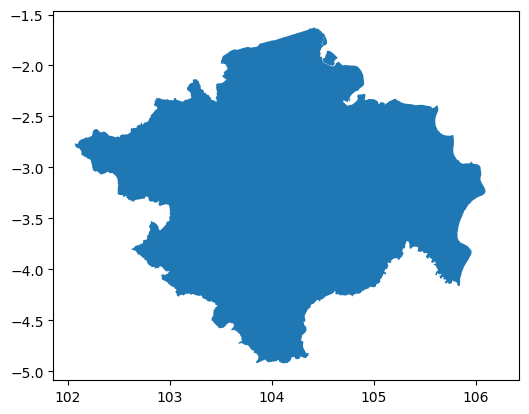

In [ ]:
gdf_boundary.plot()
plt.show()

In [ ]:
min_lat, max_lat = -4.9, -1.6
min_lon, max_lon = 102, 106
#min_lat, max_lat = -2.2, -1.6
#min_lon, max_lon = 105, 106
sumatera_selatan = df[(df['latitude'] >= min_lat) & (df['latitude'] <= max_lat) &
                            (df['longitude'] >= min_lon) & (df['longitude'] <= max_lon)]
m = folium.Map(location=[-3.5, 104], zoom_start=7)
for index, row in sumatera_selatan.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0,
        tooltip=f"Brightness: {row['brightness']}",
    ).add_to(m)
m

In [ ]:
# Nama file CSV
nama_file = 'sumatera_selatan.csv'

# Menyimpan DataFrame ke dalam file CSV
sumatera_selatan.to_csv(nama_file, index=False)

print(f'Data telah disimpan dalam file {nama_file}')

Data telah disimpan dalam file sumatera_selatan.csv


In [ ]:
dt = pd.read_csv("sumatera_selatan.csv")
dt

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-2.91970,105.61660,312.60,1.00,1.00,4/1/2019,329,Terra,MODIS,33,6.03,290.50,6.60,D,0.0
1,-2.92100,105.62560,312.80,1.00,1.00,4/1/2019,329,Terra,MODIS,43,6.03,290.60,7.00,D,0.0
2,-2.96090,105.45750,317.50,1.00,1.00,4/1/2019,329,Terra,MODIS,46,6.03,295.20,10.40,D,0.0
3,-2.96490,105.48450,310.10,1.00,1.00,4/1/2019,329,Terra,MODIS,24,6.03,286.90,5.40,D,0.0
4,-2.97780,105.51020,308.50,1.00,1.00,4/1/2019,329,Terra,MODIS,24,6.03,284.70,5.50,D,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26688,-4.49590,103.02579,316.04,1.01,1.01,21/12/2023,300,Terra,MODIS,76,6.1NRT,296.49,7.82,D,NaN
26689,-3.80170,102.27634,313.91,1.00,1.00,26/12/2023,306,Terra,MODIS,30,6.1NRT,296.41,8.59,D,NaN
26690,-2.84279,103.02186,312.94,1.02,1.01,28/12/2023,705,Aqua,MODIS,61,6.1NRT,289.50,6.96,D,NaN
26691,-2.29981,103.01700,312.44,1.02,1.01,28/12/2023,705,Aqua,MODIS,65,6.1NRT,295.08,5.35,D,NaN


In [ ]:
# Konversi koordinat menjadi titik
dt['geometry'] = dt.apply(lambda row: Point(row['longitude'], row['latitude']), axis=1)

# Buat GeoDataFrame
gdf = gpd.GeoDataFrame(dt, geometry='geometry')


In [ ]:
# Jika gdf_boundary memiliki beberapa geometri, gunakan unary_union
gdf_boundary_union = gdf_boundary.unary_union

# Filter data untuk menyertakan hanya yang berada dalam batas wilayah
gdf_within_boundary = gdf[gdf.within(gdf_boundary_union)]


In [ ]:
# Simpan data yang berada dalam batas wilayah ke CSV atau format lain
gdf_within_boundary.to_csv("sumatra_selatan.csv", index=False)


In [ ]:
sumatra_selatan = pd.read_csv("sumatra_selatan.csv")
sumatra_selatan

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type,geometry
0,-2.91970,105.61660,312.60,1.00,1.00,4/1/2019,329,Terra,MODIS,33,6.03,290.50,6.60,D,0.0,POINT (105.6166 -2.9197)
1,-2.92100,105.62560,312.80,1.00,1.00,4/1/2019,329,Terra,MODIS,43,6.03,290.60,7.00,D,0.0,POINT (105.6256 -2.921)
2,-2.96090,105.45750,317.50,1.00,1.00,4/1/2019,329,Terra,MODIS,46,6.03,295.20,10.40,D,0.0,POINT (105.4575 -2.9609)
3,-2.96490,105.48450,310.10,1.00,1.00,4/1/2019,329,Terra,MODIS,24,6.03,286.90,5.40,D,0.0,POINT (105.4845 -2.9649)
4,-2.97780,105.51020,308.50,1.00,1.00,4/1/2019,329,Terra,MODIS,24,6.03,284.70,5.50,D,0.0,POINT (105.5102 -2.9778)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18776,-3.62326,104.44801,312.78,1.70,1.28,18/12/2023,644,Aqua,MODIS,37,6.1NRT,294.01,10.28,D,NaN,POINT (104.44801 -3.62326)
18777,-3.25163,105.36668,316.16,1.44,1.19,18/12/2023,644,Aqua,MODIS,67,6.1NRT,292.73,16.63,D,NaN,POINT (105.36668 -3.25163)
18778,-3.25344,105.35394,310.23,1.44,1.19,18/12/2023,644,Aqua,MODIS,28,6.1NRT,291.58,8.93,D,NaN,POINT (105.35394 -3.25344)
18779,-2.84279,103.02186,312.94,1.02,1.01,28/12/2023,705,Aqua,MODIS,61,6.1NRT,289.50,6.96,D,NaN,POINT (103.02186 -2.84279)


In [ ]:
k = folium.Map(location=[-3.5, 104], zoom_start=7)
for index, row in sumatra_selatan.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0,
        tooltip=f"Brightness: {row['brightness']}",
    ).add_to(k)
k

In [ ]:
data = pd.read_csv("sumatra_selatan.csv")
data

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type,geometry
0,-2.91970,105.61660,312.60,1.00,1.00,4/1/2019,329,Terra,MODIS,33,6.03,290.50,6.60,D,0.0,POINT (105.6166 -2.9197)
1,-2.92100,105.62560,312.80,1.00,1.00,4/1/2019,329,Terra,MODIS,43,6.03,290.60,7.00,D,0.0,POINT (105.6256 -2.921)
2,-2.96090,105.45750,317.50,1.00,1.00,4/1/2019,329,Terra,MODIS,46,6.03,295.20,10.40,D,0.0,POINT (105.4575 -2.9609)
3,-2.96490,105.48450,310.10,1.00,1.00,4/1/2019,329,Terra,MODIS,24,6.03,286.90,5.40,D,0.0,POINT (105.4845 -2.9649)
4,-2.97780,105.51020,308.50,1.00,1.00,4/1/2019,329,Terra,MODIS,24,6.03,284.70,5.50,D,0.0,POINT (105.5102 -2.9778)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18776,-3.62326,104.44801,312.78,1.70,1.28,18/12/2023,644,Aqua,MODIS,37,6.1NRT,294.01,10.28,D,NaN,POINT (104.44801 -3.62326)
18777,-3.25163,105.36668,316.16,1.44,1.19,18/12/2023,644,Aqua,MODIS,67,6.1NRT,292.73,16.63,D,NaN,POINT (105.36668 -3.25163)
18778,-3.25344,105.35394,310.23,1.44,1.19,18/12/2023,644,Aqua,MODIS,28,6.1NRT,291.58,8.93,D,NaN,POINT (105.35394 -3.25344)
18779,-2.84279,103.02186,312.94,1.02,1.01,28/12/2023,705,Aqua,MODIS,61,6.1NRT,289.50,6.96,D,NaN,POINT (103.02186 -2.84279)


In [ ]:
# Menyisakan hanya kolom yang diinginkan
kolom_yang_ingin_disisakan = ['latitude', 'longitude', 'acq_date', 'confidence']
data_baru = data[kolom_yang_ingin_disisakan]

In [ ]:
# Memfilter berdasarkan nilai 'confidence' yang lebih besar dari 30
dataset_baru = data_baru[data_baru['confidence'] > 30]

In [ ]:
dataset_baru

,latitude,longitude,acq_date,confidence
0,-2.91970,105.61660,4/1/2019,33
1,-2.92100,105.62560,4/1/2019,43
2,-2.96090,105.45750,4/1/2019,46
5,-3.95540,103.50520,4/1/2019,63
6,-3.95750,103.48990,4/1/2019,67
...,...,...,...,...
18775,-3.62313,104.43772,18/12/2023,68
18776,-3.62326,104.44801,18/12/2023,37
18777,-3.25163,105.36668,18/12/2023,67
18779,-2.84279,103.02186,28/12/2023,61


In [ ]:
# Nama file CSV
nama_file = 'dataset_baru.csv'

# Menyimpan DataFrame ke dalam file CSV
dataset_baru.to_csv(nama_file, index=False)

print(f'Data telah disimpan dalam file {nama_file}')

Data telah disimpan dalam file dataset_baru.csv


In [ ]:
#dates = pd.to_datetime(date_strings, dayfirst=True)
dataset_baru['acq_date'] = pd.to_datetime(dataset_baru['acq_date'], dayfirst=True)

/tmp/ipykernel_5470/2391005457.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_baru['acq_date'] = pd.to_datetime(dataset_baru['acq_date'], dayfirst=True)


In [ ]:
# Mengubah kolom 'acq_date' menjadi tipe data datetime
dataset_baru['acq_date'] = pd.to_datetime(dataset_baru['acq_date'])
# Mengurutkan data berdasarkan tanggal
dataset_baru = dataset_baru.sort_values(by='acq_date')

/tmp/ipykernel_5470/1188641103.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_baru['acq_date'] = pd.to_datetime(dataset_baru['acq_date'])


In [ ]:
# Menambahkan kolom 'tahun' berdasarkan tahun pada 'acq_date'
dataset_baru['tahun'] = dataset_baru['acq_date'].dt.year

# Memilih data dengan waktu per tahun dan menyimpannya dalam file CSV
for tahun in dataset_baru['tahun'].unique():
    data_per_tahun = dataset_baru[dataset_baru['tahun'] == tahun]
    nama_file_tahun = f'sumatra_selatan_{tahun}.csv'
    data_per_tahun.to_csv(nama_file_tahun, index=False)
    print(f"Data untuk tahun {tahun} disimpan pada '{nama_file_tahun}'")


Data untuk tahun 2019 disimpan pada 'sumatra_selatan_2019.csv'
Data untuk tahun 2020 disimpan pada 'sumatra_selatan_2020.csv'
Data untuk tahun 2021 disimpan pada 'sumatra_selatan_2021.csv'
Data untuk tahun 2022 disimpan pada 'sumatra_selatan_2022.csv'
Data untuk tahun 2023 disimpan pada 'sumatra_selatan_2023.csv'


## 2019

In [ ]:
sumatra_selatan_2019 = pd.read_csv("sumatra_selatan_2019.csv")

In [ ]:
data_2019 = sumatra_selatan_2019[['latitude', 'longitude']].values

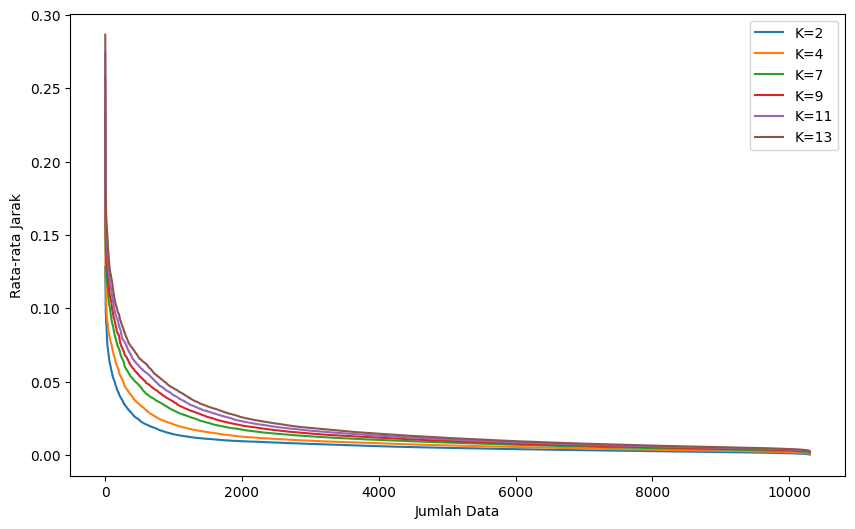

In [ ]:
# Daftar nilai K yang ingin kita uji
k_values = [2, 4, 7, 9, 11, 13]

# Matriks jarak antar titik menggunakan scipy.spatial.distance
distance_matrix = distance.cdist(data_2019, data_2019, 'euclidean')

# Fungsi untuk menghitung rata-rata jarak K tetangga terdekat
def avg_nearest_distance_for_k(K):
    nearest_neighbors = np.argsort(distance_matrix, axis=1)[:, 1:K+1]
    nearest_distances = np.array([
        [distance_matrix[i, j] for j in nearest_neighbors[i]]
        for i in range(len(data_2019))
    ])
    avg_nearest_distance = nearest_distances.mean(axis=1)
    return avg_nearest_distance

# Membuat grafik untuk setiap nilai K
plt.figure(figsize=(10, 6))

for K in k_values:
    avg_nearest_distance = avg_nearest_distance_for_k(K)
    sorted_avg_nearest_distance = np.sort(avg_nearest_distance)[::-1]  # Urutkan dari jarak terjauh ke yang terdekat
    plt.plot(range(1, len(sorted_avg_nearest_distance) + 1), sorted_avg_nearest_distance, label=f'K={K}')


plt.xlabel('Jumlah Data')
plt.ylabel('Rata-rata Jarak')
plt.legend()
plt.show()

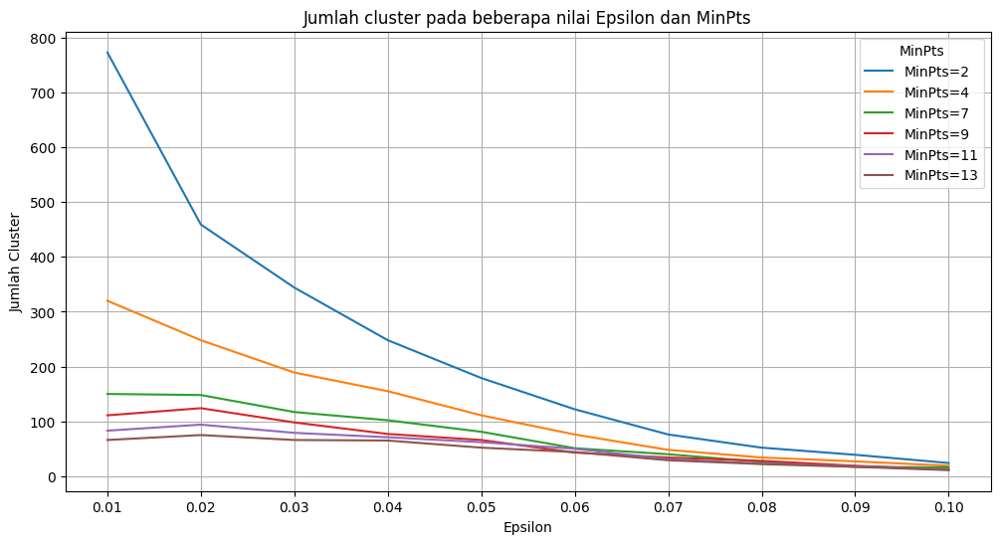

In [ ]:
data_points = sumatra_selatan_2019[['latitude', 'longitude']].values
epsilon_values = [ 0.01,0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1]
minPts_values = [2, 4, 7, 9, 11, 13]

cluster_counts = np.zeros((len(epsilon_values), len(minPts_values)))
for i, epsilon in enumerate(epsilon_values):
    for j, minPts in enumerate(minPts_values):
        dbscan = DBSCAN(eps=epsilon, min_samples=minPts, metric='euclidean')
        dbscan.fit(data_points)
        cluster_counts[i][j] = len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0)

plt.figure(figsize=(12, 6))
for j, minPts in enumerate(minPts_values):
    plt.plot(epsilon_values, cluster_counts[:, j], label=f'MinPts={minPts}')
plt.title('Jumlah cluster pada beberapa nilai Epsilon dan MinPts')
plt.xlabel('Epsilon')
plt.ylabel('Jumlah Cluster')
plt.legend(title='MinPts')
plt.grid(True)
plt.xticks(epsilon_values)
plt.show()

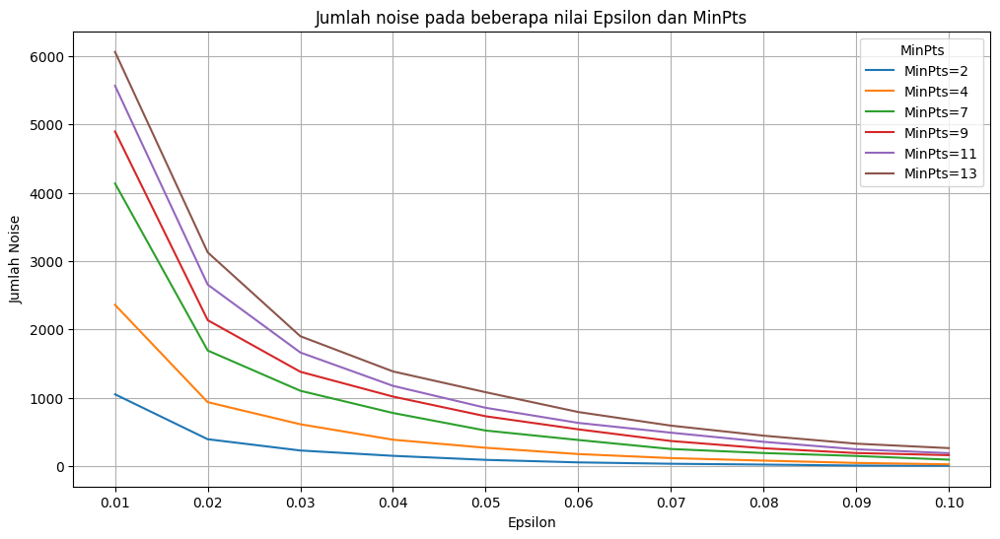

In [ ]:
data_points = sumatra_selatan_2019[['latitude', 'longitude']].values
epsilon_values = [ 0.01,0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1]
minPts_values = [2, 4, 7, 9, 11, 13]

noise_cluster_counts = np.zeros((len(epsilon_values), len(minPts_values)))

for i, epsilon in enumerate(epsilon_values):
    for j, minPts in enumerate(minPts_values):
        dbscan = DBSCAN(eps=epsilon, min_samples=minPts, metric='euclidean')
        dbscan.fit(data_points)
        noise_cluster_counts[i][j] = np.sum(dbscan.labels_ == -1)  # Menghitung jumlah data noise

plt.figure(figsize=(12, 6))
for j, minPts in enumerate(minPts_values):
    plt.plot(epsilon_values, noise_cluster_counts[:, j], label=f'MinPts={minPts}')
plt.title('Jumlah noise pada beberapa nilai Epsilon dan MinPts')
plt.xlabel('Epsilon')
plt.ylabel('Jumlah Noise')
plt.legend(title='MinPts')
plt.grid(True)
plt.xticks(epsilon_values)
plt.show()

In [ ]:
import folium
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN

import pandas as pd
import folium
from sklearn.cluster import DBSCAN

# Assuming sumatra_selatan_2019 is your original DataFrame
data_2019 = sumatra_selatan_2019[['latitude', 'longitude']]

# Ensure data_2019 is a DataFrame
if not isinstance(data_2019, pd.DataFrame):
    data_2019 = pd.DataFrame(data_2019, columns=['latitude', 'longitude'])

eps = 0.1
min_samples = 13
dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='euclidean')

# Fit the model
dbscan.fit(data_2019)

# Add the cluster labels to the DataFrame using .loc
data_2019 = data_2019.copy()  # To avoid SettingWithCopyWarning
data_2019.loc[:, 'cluster'] = dbscan.labels_

# Initialize the folium map
m = folium.Map(location=[-3.5, 104], zoom_start=7)

# Define a list of colors for the clusters
colors = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c', '#fb9a99', '#e31a1c',
          '#fdbf6f', '#ff7f00', '#cab2d6', '#6a3d9a', '#ffff99', '#b15928',
          '#5F9EA0', '#DC143C', '#00FFFF', '#B8860B', '#8B008B', '#2F4F4F']

# Dictionary to keep track of whether a cluster has been labeled
labeled_clusters = set()

# Add CircleMarkers to the map for each point, and label only the first point of each cluster
for index, row in data_2019.iterrows():
    cluster = int(row['cluster'])  # Ensure the cluster label is an integer
    if cluster == -1:
        continue  # Skip noise points
    else:
        color = colors[cluster % len(colors)]

        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            color=color,
            fill=True,
            radius=1,
            fill_color=color,
            fill_opacity=0.7
        ).add_to(m)

        # Add label only to the first point in each cluster
        if cluster not in labeled_clusters:
            labeled_clusters.add(cluster)
            folium.Marker(
                location=[row['latitude'], row['longitude']],
                icon=folium.DivIcon(
                    html=f'<div style="font-size: 8pt; color: black; padding: 2px;">{cluster}</div>'
                )
            ).add_to(m)

# Display the map
m

In [ ]:
# Add the cluster labels to the original DataFrame
sumatra_selatan_2019['cluster'] = dbscan.labels_

# Save the updated DataFrame to a CSV file
sumatra_selatan_2019.to_csv('sumatra_selatan_2019_with_clusters.csv', index=False)

In [ ]:
from prettytable import PrettyTable
from collections import Counter
import numpy as np

# Hasil DBSCAN clustering (asumsi dbscan sudah didefinisikan sebelumnya)
cluster_labels = dbscan.labels_
core_samples = np.zeros_like(cluster_labels, dtype=bool)
core_samples[dbscan.core_sample_indices_] = True
cluster_sizes = Counter(cluster_labels)
core_points_count = Counter(cluster_labels[core_samples])
border_points_count = Counter(cluster_labels[~core_samples])
unique_clusters = sorted(set(cluster_labels))

# Menghitung jumlah total titik
total_points = len(cluster_labels)

# Membuat tabel
table = PrettyTable()
table.field_names = ["Cluster", "Core Points", "Border Points", "Jumlah Total", "Persentase (%)"]

for cluster in unique_clusters:
    core_count = core_points_count[cluster]
    border_count = border_points_count[cluster]
    size = cluster_sizes[cluster]
    percentage = (size / total_points) * 100
    table.add_row([cluster, core_count, border_count, size, f"{percentage:.2f}"])

print(table)

+---------+-------------+---------------+--------------+----------------+
| Cluster | Core Points | Border Points | Jumlah Total | Persentase (%) |
+---------+-------------+---------------+--------------+----------------+
|    -1   |      0      |      263      |     263      |      2.55      |
|    0    |     6320    |       54      |     6374     |     61.87      |
|    1    |      60     |       7       |      67      |      0.65      |
|    2    |     107     |       10      |     117      |      1.14      |
|    3    |     1837    |       16      |     1853     |     17.99      |
|    4    |      22     |       5       |      27      |      0.26      |
|    5    |     1246    |       49      |     1295     |     12.57      |
|    6    |      86     |       22      |     108      |      1.05      |
|    7    |      69     |       38      |     107      |      1.04      |
|    8    |      52     |       5       |      57      |      0.55      |
|    9    |      21     |       0     

In [ ]:
# Add the cluster labels to the DataFrame using .loc
data_2019 = data_2019.copy()  # To avoid SettingWithCopyWarning
data_2019.loc[:, 'cluster'] = dbscan.labels_

# Filter the DataFrame to get the latitude and longitude of cluster 5
cluster_0_data = data_2019[data_2019['cluster'] == 0]

# Save the latitude and longitude of cluster 5 to a CSV file
cluster_0_data.to_csv('cluster_0_data_2019.csv', index=False)

print("Data cluster 5 telah disimpan ke file 'cluster_0_data_2019.csv'.")

Data cluster 5 telah disimpan ke file 'cluster_0_data_2019.csv'.


In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score

# Extract the cluster labels
labels = data_2019['cluster']

# Check if there are at least 2 clusters including noise points
unique_labels = set(labels)
if len(unique_labels) > 1:
    # Calculate silhouette scores for each sample, including noise points
    sample_silhouette_values = silhouette_samples(data_2019[['latitude', 'longitude']], labels)

    # Calculate average silhouette score excluding noise points
    silhouette_avg = silhouette_score(data_2019[['latitude', 'longitude']], labels)
    print(f"Average silhouette coefficient: {silhouette_avg:.3f}")

    # Add silhouette scores to the dataframe
    data_2019['Silhouette'] = sample_silhouette_values

    # Display silhouette scores
    print("Silhouette scores for each sample:")
    print(data_2019[['cluster', 'Silhouette']])
else:
    print("Silhouette score cannot be calculated with less than 2 clusters.")


Average silhouette coefficient: 0.309
Silhouette scores for each sample:
       cluster  Silhouette
0            0    0.156075
1            0    0.158737
2            0    0.181992
3            1    0.531050
4            1    0.538221
...        ...         ...
10297        3    0.572548
10298       -1   -0.751819
10299        0   -0.221745
10300        1    0.131446
10301        2    0.648032

[10302 rows x 2 columns]


In [ ]:
from sklearn.metrics import davies_bouldin_score
# Menghitung Davies-Bouldin Index
# Filter out noise points (with label -1)
filtered_data = data_2019[data_2019['cluster'] != -1]
if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1:
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")
else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")

Davies-Bouldin Index: 0.5579466470494595


In [ ]:
import numpy as np
from sklearn.metrics import davies_bouldin_score

# Filter out noise points (with label -1)
filtered_data = data_2019[data_2019['cluster'] != -1]

if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1: #memeriksa apakah ada titik yang tersisa setelah noise dihapus, dan memastikan ada lebih dari satu klaster dalam data yang disaring
    # Calculate Davies-Bouldin Index
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")

    # diinisialisasi untuk menyimpan nilai SSW dan SSB untuk setiap klaster.
    ssw_dict = {}
    ssb_dict = {}

    cluster_labels = np.unique(filtered_data['cluster'])

    for cluster in cluster_labels:
      #filter yang digunakan untuk memilih semua baris (titik data) yang berada dalam klaster
        cluster_points = filtered_data[filtered_data['cluster'] == cluster][['latitude', 'longitude']]
        centroid = cluster_points.mean(axis=0)

        # Calculate SSW for the cluster
        ssw = np.mean(np.sqrt(np.sum((cluster_points - centroid) ** 2, axis=1)))
        ssw_dict[cluster] = ssw

        # Calculate SSB for the cluster
        ssb = []
        #Iterasi Melalui Setiap Klaster untuk Menghitung Jarak ke Klaster Lain
        for other_cluster in cluster_labels:
            if cluster != other_cluster:
                other_cluster_points = filtered_data[filtered_data['cluster'] == other_cluster][['latitude', 'longitude']]
                other_centroid = other_cluster_points.mean(axis=0)
                ssb.append(np.sqrt(np.sum((centroid - other_centroid) ** 2)))

        # Store the minimum SSB between the current cluster and any other cluster
        ssb_dict[cluster] = min(ssb) if ssb else 0

    # Add SSW and SSB columns to the filtered_data DataFrame
    filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
    filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)

    print("SSW and SSB for each point:")
    print(filtered_data[['latitude', 'longitude', 'cluster', 'SSW', 'SSB']])

else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")


Davies-Bouldin Index: 0.5579466470494595
SSW and SSB for each point:
       latitude  longitude  cluster       SSW       SSB
0       -2.9197   105.6166        0  0.521153  1.024163
1       -2.9210   105.6256        0  0.521153  1.024163
2       -2.9609   105.4575        0  0.521153  1.024163
3       -3.9554   103.5052        1  0.117653  0.232036
4       -3.9575   103.4899        1  0.117653  0.232036
...         ...        ...      ...       ...       ...
10296   -3.5234   104.5822        0  0.521153  1.024163
10297   -2.0458   103.8687        3  0.179601  0.817673
10299   -2.7213   105.4057        0  0.521153  1.024163
10300   -3.7882   103.5362        1  0.117653  0.232036
10301   -3.8116   103.8194        2  0.128492  0.456281

[10039 rows x 5 columns]


/tmp/ipykernel_5470/793644830.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
/tmp/ipykernel_5470/793644830.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)


In [ ]:
import numpy as np
from sklearn.metrics import davies_bouldin_score

# Filter out noise points (with label -1)
filtered_data = data_2019[data_2019['cluster'] != -1]

if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1:
    # Calculate Davies-Bouldin Index
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")

    # Initialize dictionaries for storing SSW and SSB for each cluster
    ssw_dict = {}
    ssb_dict = {}

    cluster_labels = np.unique(filtered_data['cluster'])

    # Dictionary to store inter-cluster distances M_ij
    inter_cluster_distances = {}

    for cluster in cluster_labels:
        cluster_points = filtered_data[filtered_data['cluster'] == cluster][['latitude', 'longitude']]
        centroid = cluster_points.mean(axis=0)

        # Calculate SSW for the cluster
        ssw = np.mean(np.sqrt(np.sum((cluster_points - centroid) ** 2, axis=1)))
        ssw_dict[cluster] = ssw

        # Calculate SSB for the cluster and inter-cluster distances
        ssb_list = []
        inter_distances = {}
        for other_cluster in cluster_labels:
            if cluster != other_cluster:
                other_cluster_points = filtered_data[filtered_data['cluster'] == other_cluster][['latitude', 'longitude']]
                other_centroid = other_cluster_points.mean(axis=0)
                distance = np.sqrt(np.sum((centroid - other_centroid) ** 2))
                ssb_list.append(distance)
                inter_distances[other_cluster] = distance

        # Store the minimum SSB between the current cluster and any other cluster
        ssb_dict[cluster] = min(ssb_list) if ssb_list else 0
        inter_cluster_distances[cluster] = inter_distances

    # Add SSW and SSB columns to the filtered_data DataFrame
    filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
    filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)

    # Print SSW and SSB for each cluster
    print("SSW and SSB for each cluster:")
    for cluster in cluster_labels:
        print(f"Cluster {cluster}:")
        print(f"  SSW: {ssw_dict[cluster]}")
        print(f"  SSB: {ssb_dict[cluster]}")

        # Print inter-cluster distances (M_ij)
        print("  Inter-cluster distances (M_ij):")
        for other_cluster, distance in inter_cluster_distances[cluster].items():
            print(f"    M_{cluster}{other_cluster}: {distance}")
        print()

else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")


Davies-Bouldin Index: 0.5579466470494595
SSW and SSB for each cluster:
Cluster 0:
  SSW: 0.5211528978689652
  SSB: 1.0241633018000789
  Inter-cluster distances (M_ij):
    M_01: 1.806482607189686
    M_02: 1.3557641249449779
    M_03: 1.833432254096812
    M_04: 1.0241633018000789
    M_05: 1.9650069409234352
    M_06: 2.237078702757067
    M_07: 1.4319739951443518
    M_08: 1.1992033715530688
    M_09: 1.0450124743318434
    M_010: 1.8412564248703254

Cluster 1:
  SSW: 0.11765256772076951
  SSB: 0.23203592377519486
  Inter-cluster distances (M_ij):
    M_10: 1.806482607189686
    M_12: 0.456281330289635
    M_13: 2.1513587405574914
    M_14: 1.8713327298997977
    M_15: 1.1512319192135765
    M_16: 0.5277709694120463
    M_17: 0.8588446346126838
    M_18: 1.4184558389248674
    M_19: 2.1443911234432345
    M_110: 0.23203592377519486

Cluster 2:
  SSW: 0.12849153375313166
  SSB: 0.456281330289635
  Inter-cluster distances (M_ij):
    M_20: 1.3557641249449779
    M_21: 0.456281330289635

/tmp/ipykernel_5470/707912272.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
/tmp/ipykernel_5470/707912272.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)


In [ ]:
# Filter out noise points (with label -1) untuk perhitungan DBI
filtered_data = data_2019[data_2019['cluster'] != -1]

# Pastikan ada lebih dari satu cluster untuk menghitung DBI
if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1:
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")
else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")

Davies-Bouldin Index: 0.5579466470494595


In [ ]:
from sklearn.metrics import davies_bouldin_score
# Evaluate the clustering with Davies-Bouldin Index
# Note: Davies-Bouldin Index does not handle clusters with only one point well.
# We should handle this case appropriately if it arises.
if len(unique_labels) > 1:
    db_index = davies_bouldin_score(data_2019[['latitude', 'longitude']], labels)
    print("Davies-Bouldin Index:", db_index)
else:
    print("Davies-Bouldin Index cannot be computed for a single cluster.")

Davies-Bouldin Index: 1.4501066746878724


## 2023

In [ ]:
sumatra_selatan_2023 = pd.read_csv("sumatra_selatan_2023.csv")

In [ ]:
data_2023 = sumatra_selatan_2023[['latitude', 'longitude']].values

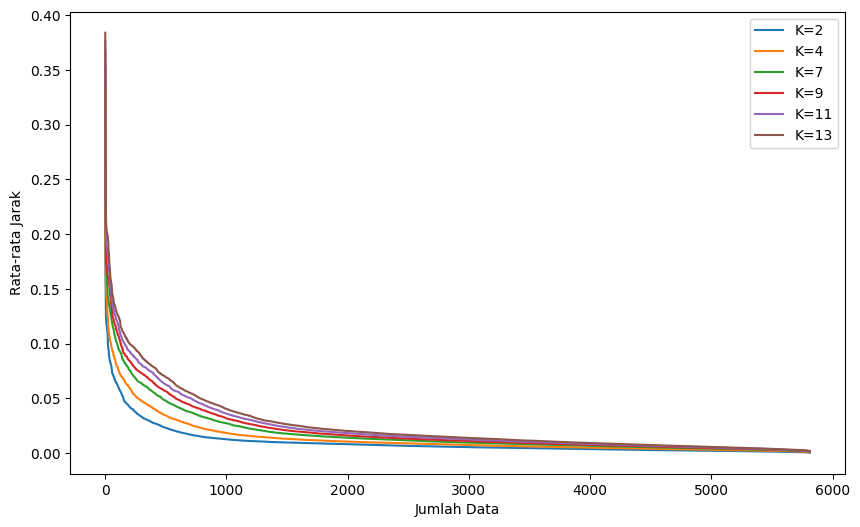

In [ ]:
from scipy.spatial import distance
# Daftar nilai K yang ingin kita uji
k_values = [2, 4, 7, 9, 11, 13]

# Matriks jarak antar titik menggunakan scipy.spatial.distance
distance_matrix = distance.cdist(data_2023, data_2023, 'euclidean')

# Fungsi untuk menghitung rata-rata jarak K tetangga terdekat
def avg_nearest_distance_for_k(K):
    nearest_neighbors = np.argsort(distance_matrix, axis=1)[:, 1:K+1]
    nearest_distances = np.array([
        [distance_matrix[i, j] for j in nearest_neighbors[i]]
        for i in range(len(data_2023))
    ])
    avg_nearest_distance = nearest_distances.mean(axis=1)
    return avg_nearest_distance

# Membuat grafik untuk setiap nilai K
plt.figure(figsize=(10, 6))

for K in k_values:
    avg_nearest_distance = avg_nearest_distance_for_k(K)
    sorted_avg_nearest_distance = np.sort(avg_nearest_distance)[::-1]
    plt.plot(range(1, len(sorted_avg_nearest_distance) + 1), sorted_avg_nearest_distance, label=f'K={K}')


plt.xlabel('Jumlah Data')
plt.ylabel('Rata-rata Jarak')
plt.legend()
plt.show()

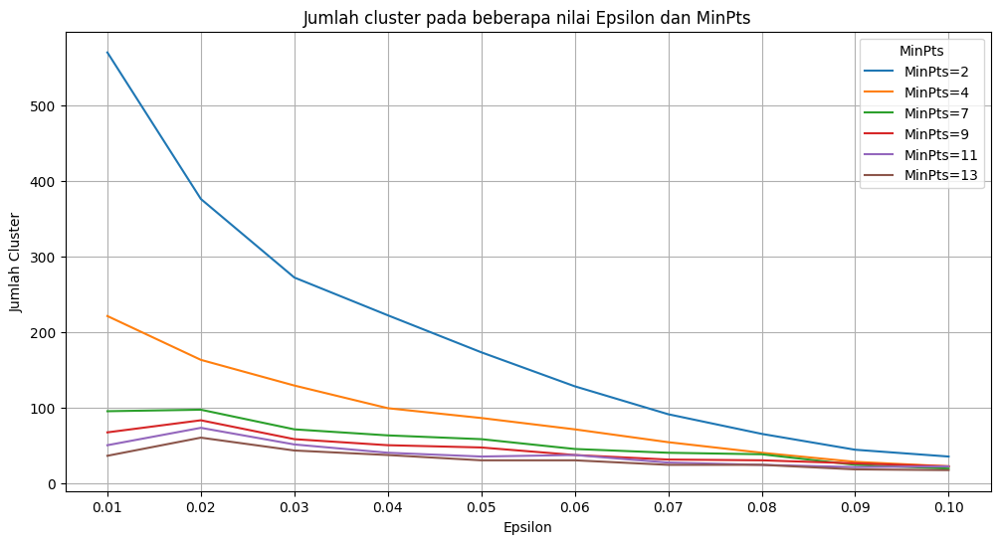

In [ ]:
data_points = sumatra_selatan_2023[['latitude', 'longitude']].values
epsilon_values = [ 0.01,0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1]
minPts_values = [2, 4, 7, 9, 11, 13]

cluster_counts = np.zeros((len(epsilon_values), len(minPts_values)))
for i, epsilon in enumerate(epsilon_values):
    for j, minPts in enumerate(minPts_values):
        dbscan = DBSCAN(eps=epsilon, min_samples=minPts, metric='euclidean')
        dbscan.fit(data_points)
        cluster_counts[i][j] = len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0)

plt.figure(figsize=(12, 6))
for j, minPts in enumerate(minPts_values):
    plt.plot(epsilon_values, cluster_counts[:, j], label=f'MinPts={minPts}')
plt.title('Jumlah cluster pada beberapa nilai Epsilon dan MinPts')
plt.xlabel('Epsilon')
plt.ylabel('Jumlah Cluster')
plt.legend(title='MinPts')
plt.grid(True)
plt.xticks(epsilon_values)
plt.show()

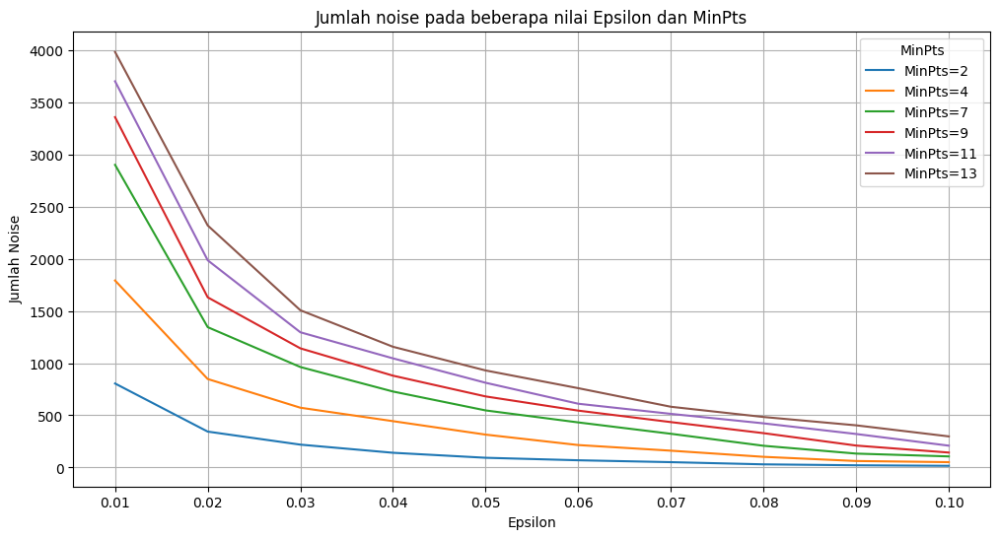

In [ ]:
data_points = sumatra_selatan_2023[['latitude', 'longitude']].values
epsilon_values = [ 0.01,0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1]
minPts_values = [2, 4, 7, 9, 11, 13]

noise_cluster_counts = np.zeros((len(epsilon_values), len(minPts_values)))

for i, epsilon in enumerate(epsilon_values):
    for j, minPts in enumerate(minPts_values):
        dbscan = DBSCAN(eps=epsilon, min_samples=minPts, metric='euclidean')
        dbscan.fit(data_points)
        noise_cluster_counts[i][j] = np.sum(dbscan.labels_ == -1)  # Menghitung jumlah data noise

plt.figure(figsize=(12, 6))
for j, minPts in enumerate(minPts_values):
    plt.plot(epsilon_values, noise_cluster_counts[:, j], label=f'MinPts={minPts}')
plt.title('Jumlah noise pada beberapa nilai Epsilon dan MinPts')
plt.xlabel('Epsilon')
plt.ylabel('Jumlah Noise')
plt.legend(title='MinPts')
plt.grid(True)
plt.xticks(epsilon_values)
plt.show()

In [ ]:
import folium
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN

# Assuming sumatra_selatan_2019 is your original DataFrame
data_2023 = sumatra_selatan_2023[['latitude', 'longitude']]

# Ensure data_2019 is a DataFrame
if not isinstance(data_2023, pd.DataFrame):
    data_2023 = pd.DataFrame(data_2023, columns=['latitude', 'longitude'])

eps = 0.1
min_samples = 11
dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='euclidean')

# Fit the model
dbscan.fit(data_2023)

# Add the cluster labels to the DataFrame using .loc
data_2023 = data_2023.copy()  # To avoid SettingWithCopyWarning
data_2023.loc[:, 'cluster'] = dbscan.labels_

# Initialize the folium map
m = folium.Map(location=[-3.5, 104], zoom_start=7)

# Define a list of colors for the clusters
colors = ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c', '#fb9a99', '#e31a1c',
          '#fdbf6f', '#ff7f00', '#cab2d6', '#6a3d9a', '#ffff99', '#b15928',
          '#5F9EA0', '#DC143C', '#00FFFF', '#B8860B', '#8B008B', '#2F4F4F']
# Dictionary to keep track of whether a cluster has been labeled
labeled_clusters = set()

# Add CircleMarkers to the map for each point, and label only the first point of each cluster
for index, row in data_2023.iterrows():
    cluster = int(row['cluster'])  # Ensure the cluster label is an integer
    if cluster == -1:
        continue  # Skip noise points
    else:
        color = colors[cluster % len(colors)]

        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=1,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7
        ).add_to(m)

        # Add label only to the first point in each cluster
        if cluster not in labeled_clusters:
            labeled_clusters.add(cluster)
            folium.Marker(
                location=[row['latitude'], row['longitude']],
                icon=folium.DivIcon(
                    html=f'<div style="font-size: 8pt; color: black; padding: 2px;">{cluster}</div>'
                )
            ).add_to(m)

# Display the map
m

In [ ]:
from prettytable import PrettyTable
from collections import Counter
import numpy as np

# Hasil DBSCAN clustering (asumsi dbscan sudah didefinisikan sebelumnya)
cluster_labels = dbscan.labels_
core_samples = np.zeros_like(cluster_labels, dtype=bool)
core_samples[dbscan.core_sample_indices_] = True
cluster_sizes = Counter(cluster_labels)
core_points_count = Counter(cluster_labels[core_samples])
border_points_count = Counter(cluster_labels[~core_samples])
unique_clusters = sorted(set(cluster_labels))

# Menghitung jumlah total titik
total_points = len(cluster_labels)

# Membuat tabel
table = PrettyTable()
table.field_names = ["Cluster", "Core Points", "Border Points", "Jumlah Total", "Persentase (%)"]

for cluster in unique_clusters:
    core_count = core_points_count[cluster]
    border_count = border_points_count[cluster]
    size = cluster_sizes[cluster]
    percentage = (size / total_points) * 100
    table.add_row([cluster, core_count, border_count, size, f"{percentage:.2f}"])

print(table)

+---------+-------------+---------------+--------------+----------------+
| Cluster | Core Points | Border Points | Jumlah Total | Persentase (%) |
+---------+-------------+---------------+--------------+----------------+
|    -1   |      0      |      209      |     209      |      3.60      |
|    0    |      2      |       14      |      16      |      0.28      |
|    1    |     4256    |       40      |     4296     |     73.92      |
|    2    |      88     |       16      |     104      |      1.79      |
|    3    |     210     |       13      |     223      |      3.84      |
|    4    |     307     |       25      |     332      |      5.71      |
|    5    |      41     |       11      |      52      |      0.89      |
|    6    |      83     |       6       |      89      |      1.53      |
|    7    |      73     |       1       |      74      |      1.27      |
|    8    |      16     |       3       |      19      |      0.33      |
|    9    |      13     |       5     

In [ ]:
# Add the cluster labels to the DataFrame using .loc
data_2023 = data_2023.copy()  # To avoid SettingWithCopyWarning
data_2023.loc[:, 'cluster'] = dbscan.labels_

# Filter the DataFrame to get the latitude and longitude of cluster 5
cluster_1_data = data_2023[data_2023['cluster'] == 1]

# Save the latitude and longitude of cluster 5 to a CSV file
cluster_1_data.to_csv('cluster_1_data_2023.csv', index=False)

print("Data cluster 5 telah disimpan ke file 'cluster_1_data_2023.csv'.")

Data cluster 5 telah disimpan ke file 'cluster_1_data_2023.csv'.


In [ ]:
# Calculate silhouette scores
labels = data_2023['cluster']

unique_labels = set(labels)
# Check if there are at least 2 clusters (excluding noise points)
if len(unique_labels) > 1:
    # Calculate silhouette score
    silhouette_avg = silhouette_score(data_2023[['latitude', 'longitude']], labels)
    print(f"Average silhouette coefficient: {silhouette_avg:.3f}")

    # Calculate silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data_2023[['latitude', 'longitude']], labels)
    data_2023['Silhouette'] = sample_silhouette_values

    # Display silhouette scores
    print("Silhouette scores for each sample:")
    print(data_2023[['cluster', 'Silhouette']])
else:
    print("Silhouette score cannot be calculated with less than 2 clusters.")

Average silhouette coefficient: 0.296
Silhouette scores for each sample:
      cluster  Silhouette
0          -1   -0.605170
1          -1   -0.610214
2           0    0.378854
3          -1   -0.863854
4           0    0.521496
...       ...         ...
5807        9    0.591167
5808        1   -0.452419
5809        1    0.409952
5810        4   -0.008449
5811       -1   -0.767090

[5812 rows x 2 columns]


In [ ]:
from sklearn.metrics import davies_bouldin_score
# Menghitung Davies-Bouldin Index
# Filter out noise points (with label -1)
filtered_data = data_2023[data_2023['cluster'] != -1]
if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1:
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")
else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")

Davies-Bouldin Index: 0.5950407408467965


In [ ]:
import numpy as np
from sklearn.metrics import davies_bouldin_score

# Filter out noise points (with label -1)
filtered_data = data_2023[data_2023['cluster'] != -1]

if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1:
    # Calculate Davies-Bouldin Index
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")

    # Initialize dictionaries for storing SSW and SSB for each cluster
    ssw_dict = {}
    ssb_dict = {}

    cluster_labels = np.unique(filtered_data['cluster'])

    for cluster in cluster_labels:
        cluster_points = filtered_data[filtered_data['cluster'] == cluster][['latitude', 'longitude']]
        centroid = cluster_points.mean(axis=0)

        # Calculate SSW for the cluster
        ssw = np.mean(np.sqrt(np.sum((cluster_points - centroid) ** 2, axis=1)))
        ssw_dict[cluster] = ssw

        # Calculate SSB for the cluster
        ssb = []
        for other_cluster in cluster_labels:
            if cluster != other_cluster:
                other_cluster_points = filtered_data[filtered_data['cluster'] == other_cluster][['latitude', 'longitude']]
                other_centroid = other_cluster_points.mean(axis=0)
                ssb.append(np.sqrt(np.sum((centroid - other_centroid) ** 2)))

        # Store the minimum SSB between the current cluster and any other cluster
        ssb_dict[cluster] = min(ssb) if ssb else 0

    # Add SSW and SSB columns to the filtered_data DataFrame
    filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
    filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)

    print("SSW and SSB for each point:")
    print(filtered_data[['latitude', 'longitude', 'cluster', 'SSW', 'SSB']])

else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")

Davies-Bouldin Index: 0.5950407408467965
SSW and SSB for each point:
      latitude  longitude  cluster       SSW       SSB
2     -3.66064  103.05637        0  0.083211  0.161310
4     -3.70981  103.03297        0  0.083211  0.161310
5     -3.71110  103.02403        0  0.083211  0.161310
6     -3.66193  103.04746        0  0.083211  0.161310
7     -2.86992  103.24481        4  0.231185  0.387783
...        ...        ...      ...       ...       ...
5806  -3.62988  105.05663        1  0.360595  0.875769
5807  -3.86459  102.86697        9  0.064191  0.245072
5808  -3.62313  104.43772        1  0.360595  0.875769
5809  -3.25163  105.36668        1  0.360595  0.875769
5810  -2.84279  103.02186        4  0.231185  0.387783

[5603 rows x 5 columns]


/tmp/ipykernel_5470/982033965.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
/tmp/ipykernel_5470/982033965.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)


In [ ]:
import numpy as np
from sklearn.metrics import davies_bouldin_score

# Filter out noise points (with label -1)
filtered_data = data_2023[data_2023['cluster'] != -1]

if len(filtered_data) > 0 and len(np.unique(filtered_data['cluster'])) > 1:
    # Calculate Davies-Bouldin Index
    dbi = davies_bouldin_score(filtered_data[['latitude', 'longitude']], filtered_data['cluster'])
    print(f"Davies-Bouldin Index: {dbi}")

    # Initialize dictionaries for storing SSW and SSB for each cluster
    ssw_dict = {}
    ssb_dict = {}

    cluster_labels = np.unique(filtered_data['cluster'])

    # Dictionary to store inter-cluster distances M_ij
    inter_cluster_distances = {}

    for cluster in cluster_labels:
        cluster_points = filtered_data[filtered_data['cluster'] == cluster][['latitude', 'longitude']]
        centroid = cluster_points.mean(axis=0)

        # Calculate SSW for the cluster
        ssw = np.mean(np.sqrt(np.sum((cluster_points - centroid) ** 2, axis=1)))
        ssw_dict[cluster] = ssw

        # Calculate SSB for the cluster and inter-cluster distances
        ssb_list = []
        inter_distances = {}
        for other_cluster in cluster_labels:
            if cluster != other_cluster:
                other_cluster_points = filtered_data[filtered_data['cluster'] == other_cluster][['latitude', 'longitude']]
                other_centroid = other_cluster_points.mean(axis=0)
                distance = np.sqrt(np.sum((centroid - other_centroid) ** 2))
                ssb_list.append(distance)
                inter_distances[other_cluster] = distance

        # Store the minimum SSB between the current cluster and any other cluster
        ssb_dict[cluster] = min(ssb_list) if ssb_list else 0
        inter_cluster_distances[cluster] = inter_distances

    # Add SSW and SSB columns to the filtered_data DataFrame
    filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
    filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)

    # Print SSW and SSB for each cluster
    print("SSW and SSB for each cluster:")
    for cluster in cluster_labels:
        print(f"Cluster {cluster}:")
        print(f"  SSW: {ssw_dict[cluster]}")
        print(f"  SSB: {ssb_dict[cluster]}")

        # Print inter-cluster distances (M_ij)
        print("  Inter-cluster distances (M_ij):")
        for other_cluster, distance in inter_cluster_distances[cluster].items():
            print(f"    M_{cluster}{other_cluster}: {distance}")
        print()

else:
    print("Davies-Bouldin Index cannot be calculated due to insufficient clusters.")

Davies-Bouldin Index: 0.5950407408467965
SSW and SSB for each cluster:
Cluster 0:
  SSW: 0.08321134165151364
  SSB: 0.1613099360780866
  Inter-cluster distances (M_ij):
    M_01: 2.2054477232415435
    M_02: 1.3853790709203593
    M_03: 1.2146489781952354
    M_04: 0.9471060719046606
    M_05: 0.7957677942450967
    M_06: 0.6650602931745226
    M_07: 1.3976050143255938
    M_08: 1.8480909104725332
    M_09: 0.2450719820651444
    M_010: 0.555011003163399
    M_011: 0.610141310409401
    M_012: 2.1280717086714747
    M_013: 1.0010510867190496
    M_014: 0.1882451729873935
    M_015: 1.5115970898080506
    M_016: 0.1613099360780866
    M_017: 1.8359627275666484
    M_018: 0.3262526780649123
    M_019: 0.48771480042031173
    M_020: 2.6967540105157637
    M_021: 1.4499677254183043

Cluster 1:
  SSW: 0.3605949869998571
  SSB: 0.8757690794968015
  Inter-cluster distances (M_ij):
    M_10: 2.2054477232415435
    M_12: 1.4046079411150236
    M_13: 1.1743832101604832
    M_14: 2.20825227833534

/tmp/ipykernel_5470/1779140463.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSW'] = filtered_data['cluster'].map(ssw_dict)
/tmp/ipykernel_5470/1779140463.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['SSB'] = filtered_data['cluster'].map(ssb_dict)
